# Data preparation

Imports and definitions

In [1]:
import pandas as pd
import numpy as np
import glob, os
from datetime import timedelta
import matplotlib.pyplot as plt
import statsmodels.api as sm
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from dataprep.eda import create_report
from src.utils import read_sleep_file, read_hr_file, UTC2epoch

%matplotlib inline

plt.rcParams['figure.figsize'] = (10, 5)
plt.rcParams['figure.dpi'] = 200
#from src.utils import read_sleep_file
PWD = os.getcwd()
print(PWD)
DATA_DIR = 'data/s2'
FILE_TYPE = '*' #'ENHANCED_TENTATIVE'
FILES_DIR = os.path.join(PWD, DATA_DIR, 'Garmin_Data\Sleep')
HR_FILE = os.path.join(PWD, DATA_DIR, 'Garmin_Data\daily_hr.csv')
STRESS_FILE = os.path.join(PWD, DATA_DIR, 'Garmin_Data\stress.csv')
#HR_EXT_FILE = os.path.join(PWD, DATA_DIR, 'Garmin_Data/HR_extended.csv')
QUEST_FILE = os.path.join(PWD, DATA_DIR, 'Questionnaire\Sleep_questions(BxOzK).csv')

print(FILES_DIR)
SLEEP_DATA_COLS = ['calendar_date', 'local_start_time', 'local_end_time', 
                      'duration_in_seconds', 'awake_time', 'deep_sleep_time', 
                      'rem_sleep_time'] 
HR_DATA_COLS = ['local_start_time', 'hr']
STRESS_DATA_COLS = ['local_start_time', 'stress_level']
DATE_COLS = ['calendar_date', 'local_start_time', 'local_end_time']
QUEST_COLS = [0, 6, 7, 8, 9]

SCORE_DICT = dict({'Very good': 5, 'Fairly good': 4, 'Okay': 3, 'Fairly bad': 2, 'Very bad': 1,
                  'Very well': 5, 'Fairly well': 4, 'Fairly badly': 2, 'Very badly': 1,
                  'very good': 5, 'fairly good': 4, 'neutral': 3, 'fairly bad': 2, 'very bad': 1})
OUTPUT_FILE = os.path.join(PWD, 'out', 'processed_data.csv')

C:\Users\Garzon\Documents\Projects\DigBio
C:\Users\Garzon\Documents\Projects\DigBio\data/s2\Garmin_Data\Sleep


Select files 

In [2]:
os.chdir(FILES_DIR)

files = glob.glob(f'*{FILE_TYPE}*.csv')
df = pd.DataFrame({'name': files})
file_types = ['ENHANCED_FINAL','ENHANCED_TENTATIVE','AUTO_FINAL','AUTO_TENTATIVE'] 

df['type'] = df.name.apply(lambda x: [y for y in file_types if y in x][0])
df['date'] = df.name.str[:8]
df['type_order'] = df['type'].apply(lambda x: file_types.index(x))
df = df.sort_values('type_order') 
df_group = df.groupby('date').first()
#print(df_group)

files = df_group.name.to_list()
print(files[:20])

['20220708-213100(ENHANCED_TENTATIVE)_sleep.csv', '20220709-224100(ENHANCED_TENTATIVE)_sleep.csv', '20220710-213200(ENHANCED_TENTATIVE)_sleep.csv', '20220711-215200(ENHANCED_TENTATIVE)_sleep.csv', '20220712-212000(ENHANCED_TENTATIVE)_sleep.csv', '20220713-213400(ENHANCED_TENTATIVE)_sleep.csv', '20220714-220000(ENHANCED_TENTATIVE)_sleep.csv', '20220715-230600(ENHANCED_TENTATIVE)_sleep.csv', '20220716-221800(ENHANCED_TENTATIVE)_sleep.csv', '20220717-214800(ENHANCED_TENTATIVE)_sleep.csv', '20220718-223000(ENHANCED_TENTATIVE)_sleep.csv', '20220719-215800(ENHANCED_TENTATIVE)_sleep.csv', '20220720-221700(ENHANCED_TENTATIVE)_sleep.csv', '20220721-222000(ENHANCED_TENTATIVE)_sleep.csv', '20220722-225300(ENHANCED_TENTATIVE)_sleep.csv', '20220723-223900(ENHANCED_TENTATIVE)_sleep.csv', '20220724-230500(ENHANCED_TENTATIVE)_sleep.csv', '20220725-215500(ENHANCED_TENTATIVE)_sleep.csv', '20220726-224200(ENHANCED_TENTATIVE)_sleep.csv', '20220727-220000(ENHANCED_TENTATIVE)_sleep.csv']


Read files

In [3]:
# sleep
sleep_data = pd.concat([ read_sleep_file(file) for file in files] )

sleep_data = sleep_data[SLEEP_DATA_COLS]
sleep_data.head()

# hr
hr_data = read_hr_file(HR_FILE)[HR_DATA_COLS]
#hr_ext_data = pd.read_csv(HR_EXT_FILE, sep = ';')
stress_data = read_hr_file(STRESS_FILE)[STRESS_DATA_COLS]
quest_data = read_hr_file(QUEST_FILE).iloc[:, QUEST_COLS]

Create new variables

In [4]:
sleep_data['total_sleep_hours'] = sleep_data['duration_in_seconds']/(60*60)
sleep_data['deep_sleep_percentage'] = sleep_data['deep_sleep_time']/sleep_data['duration_in_seconds']
sleep_data['rem_sleep_percentage'] = sleep_data['rem_sleep_time']/sleep_data['duration_in_seconds']
sleep_data['awake_percentage'] = sleep_data['awake_time']/sleep_data['duration_in_seconds']
sleep_data[DATE_COLS] = sleep_data[DATE_COLS].apply(pd.to_datetime, axis=1)
sleep_data['calendar_date'] = sleep_data['calendar_date'] - timedelta(days=1)
sleep_data['calendar_date'] = sleep_data['calendar_date'].dt.strftime('%Y-%m-%d')

sleep_data['local_start_time_seconds'] = sleep_data['local_start_time'].apply(lambda x: UTC2epoch(x))
sleep_data['local_end_time_seconds'] = sleep_data['local_end_time'].apply(lambda x: UTC2epoch(x))

sleep_data['total_sleep_hours_round'] = sleep_data['total_sleep_hours'].apply(np.floor)

sleep_data = sleep_data.sort_values(by=['calendar_date']).reset_index()

hr_data['local_start_time_orig'] = hr_data['local_start_time']
stress_data['local_start_time_orig'] = stress_data['local_start_time']

hr_data['local_start_time'] = hr_data['local_start_time'].apply(lambda x: UTC2epoch(x))
stress_data['local_start_time'] = stress_data['local_start_time'].apply(lambda x: UTC2epoch(x))

quest_data['perceived_sleep_quality'] = quest_data.iloc[:, 3].replace(SCORE_DICT)
quest_data['estimated_sleep_time'] = quest_data.iloc[:, 1]
quest_data['feeling_rested'] = quest_data.iloc[:, 4].replace(SCORE_DICT)
quest_data['calendar_date'] = quest_data['calendar_date'].apply(pd.to_datetime) - timedelta(days=1)
quest_data['calendar_date'] = quest_data['calendar_date'].dt.strftime('%Y-%m-%d')

quest_data['bad_sleep_outlier_binary'] = (quest_data['perceived_sleep_quality'] < \
quest_data['perceived_sleep_quality'].mean() - quest_data['perceived_sleep_quality'].std())*1
quest_data['good_night'] = 1*(quest_data['perceived_sleep_quality'] > 3)
# merge sleep and questionnaire data
sleep_data = sleep_data.merge(quest_data[['calendar_date', 'perceived_sleep_quality', 'bad_sleep_outlier_binary', 'good_night']], 
                              on = 'calendar_date', how = 'right')


In [5]:
print(hr_data.shape)

(121097, 3)


Sync data

In [6]:
# select only rows during the night
hr_ext_data = []
stress_data_ext = []
for ind, row in sleep_data.iterrows():
    cond_hr = (hr_data['local_start_time'] >= row['local_start_time_seconds']) & \
    (hr_data['local_start_time'] <= row['local_end_time_seconds']) & \
    (hr_data['hr'] >= 0)
    hr_data_sub = hr_data[cond_hr].copy()
    sleep_data.loc[ind, 'median_hr_sleep'] = hr_data_sub['hr'].median()
    cond_stress = (stress_data['local_start_time'] >= row['local_start_time_seconds']) & \
    (stress_data['local_start_time'] <= row['local_end_time_seconds']) & \
    (stress_data['stress_level'] >= 0)
    stress_data_sub = stress_data[cond_stress].copy()
    sleep_data.loc[ind, 'median_stress_sleep'] = stress_data_sub['stress_level'].median()
    sleep_data.loc[ind, 'sleep_event_number'] = (ind + 1)

    hr_data_sub['sleep_event_number'] = (ind + 1)
    stress_data_sub['sleep_event_number'] = (ind + 1)
    
    hr_ext_data.append(hr_data_sub)
    stress_data_ext.append(stress_data_sub)
    
hr_ext_data = pd.concat(hr_ext_data)
stress_data_ext = pd.concat(stress_data_ext)

print(hr_ext_data)
sleep_data = sleep_data.astype({'sleep_event_number': 'int'})

# save sleep data
sleep_data.to_csv(OUTPUT_FILE, sep =';')
sleep_data.head()

        local_start_time  hr local_start_time_orig  sleep_event_number
1411          1657495920  77   2022-07-10 23:32:00                   1
1412          1657495980  80   2022-07-10 23:33:00                   1
1413          1657496040  58   2022-07-10 23:34:00                   1
1414          1657496100  55   2022-07-10 23:35:00                   1
1415          1657496160  55   2022-07-10 23:36:00                   1
...                  ...  ..                   ...                 ...
113366        1664871780  55   2022-10-04 08:23:00                  63
113367        1664871840  55   2022-10-04 08:24:00                  63
113368        1664871900  51   2022-10-04 08:25:00                  63
113369        1664871960  52   2022-10-04 08:26:00                  63
113370        1664872020  53   2022-10-04 08:27:00                  63

[30300 rows x 4 columns]


,index,calendar_date,local_start_time,local_end_time,duration_in_seconds,awake_time,deep_sleep_time,rem_sleep_time,total_sleep_hours,deep_sleep_percentage,...,awake_percentage,local_start_time_seconds,local_end_time_seconds,total_sleep_hours_round,perceived_sleep_quality,bad_sleep_outlier_binary,good_night,median_hr_sleep,median_stress_sleep,sleep_event_number
0,0.0,2022-07-10,2022-07-10 23:32:00,2022-07-11 08:10:00,31080.0,0.0,7980.0,4860.0,8.633333,0.256757,...,0.000000,1.657496e+09,1.657527e+09,8.0,4,0,1,46.0,8.0,1
1,0.0,2022-07-11,2022-07-11 23:52:00,2022-07-12 08:02:00,29400.0,120.0,5520.0,4860.0,8.166667,0.187755,...,0.004082,1.657584e+09,1.657613e+09,8.0,3,0,0,49.0,16.0,2
2,0.0,2022-07-12,2022-07-12 23:20:00,2022-07-13 07:25:00,29100.0,180.0,3660.0,5640.0,8.083333,0.125773,...,0.006186,1.657668e+09,1.657697e+09,8.0,2,1,0,46.0,11.0,3
3,0.0,2022-07-13,2022-07-13 23:34:00,2022-07-14 07:47:00,29580.0,480.0,2700.0,4500.0,8.216667,0.091278,...,0.016227,1.657755e+09,1.657785e+09,8.0,3,0,0,45.0,10.0,4
4,0.0,2022-07-14,2022-07-15 00:00:00,2022-07-15 07:52:00,28320.0,180.0,1320.0,8040.0,7.866667,0.046610,...,0.006356,1.657843e+09,1.657872e+09,7.0,2,1,0,45.0,9.5,5


Create a histogram and time series

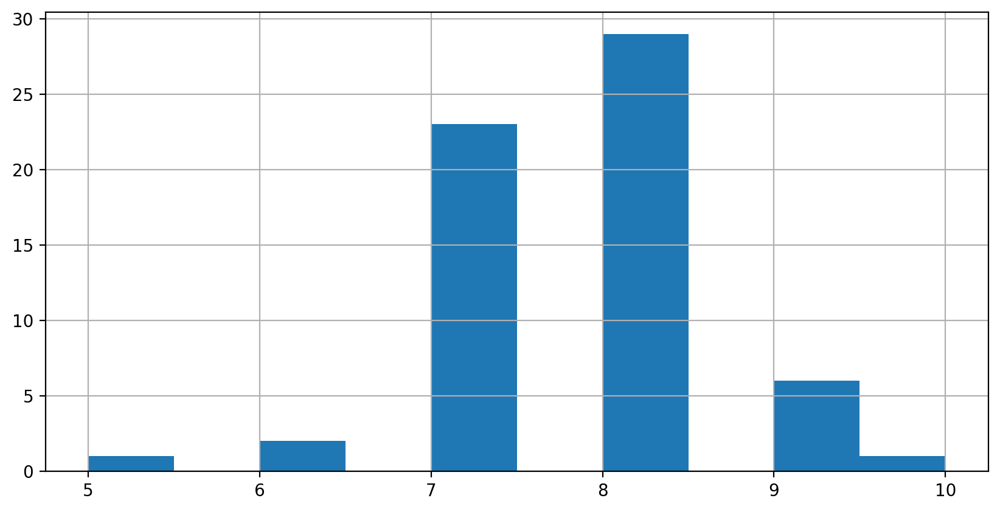

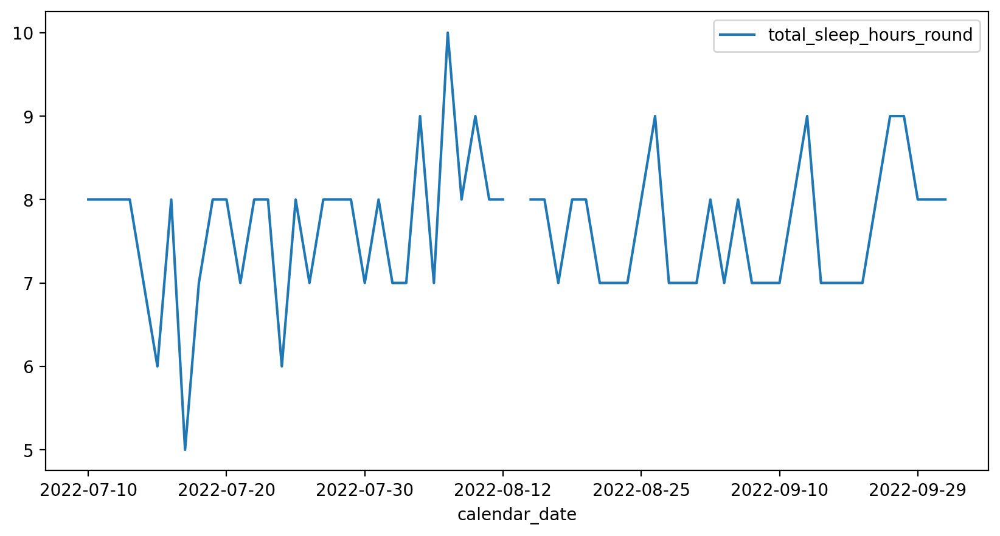

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.016
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.9946
Date:                Sat, 15 Oct 2022   Prob (F-statistic):              0.323
Time:                        14:41:59   Log-Likelihood:                -75.534
No. Observations:                  62   AIC:                             155.1
Df Residuals:                      60   BIC:                             159.3
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.6452      0.106     72.378      0.0

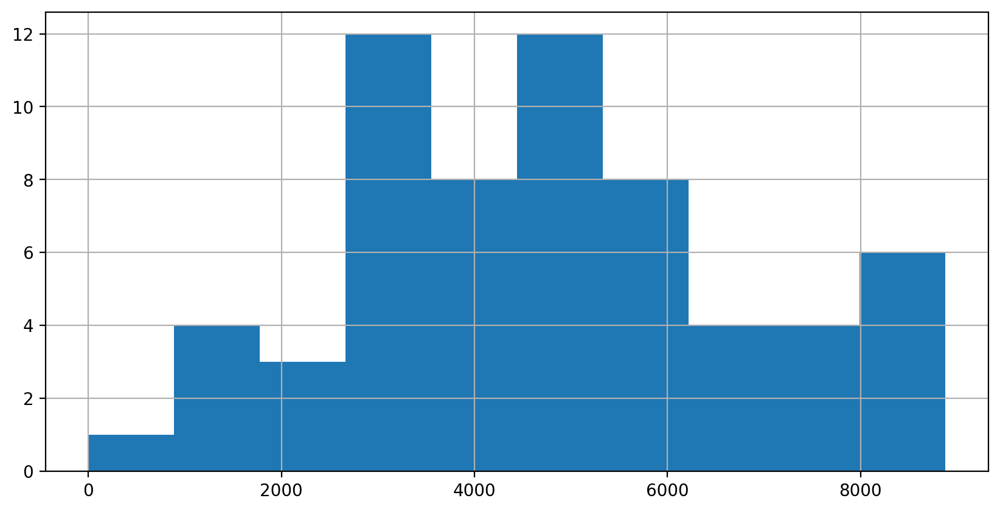

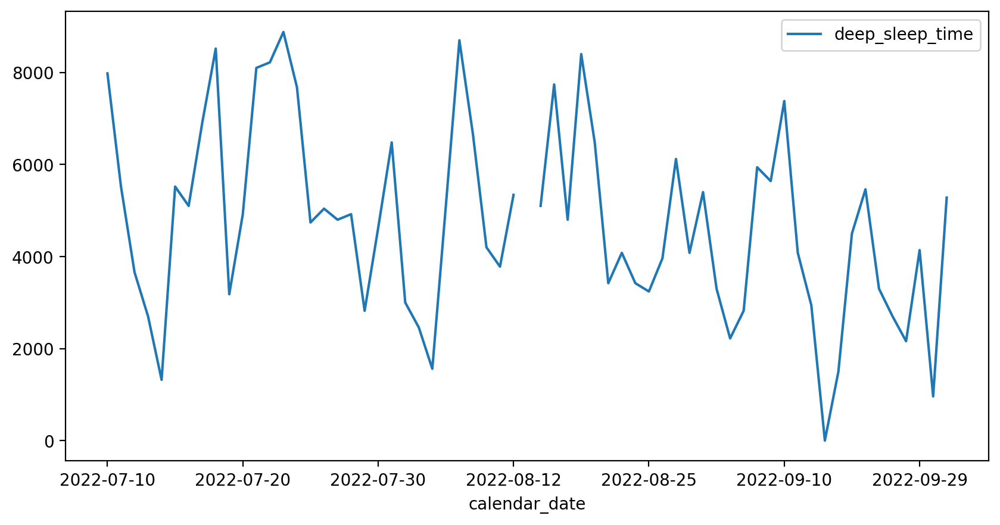

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.117
Model:                            OLS   Adj. R-squared:                  0.103
Method:                 Least Squares   F-statistic:                     7.983
Date:                Sat, 15 Oct 2022   Prob (F-statistic):            0.00640
Time:                        14:41:59   Log-Likelihood:                -557.67
No. Observations:                  62   AIC:                             1119.
Df Residuals:                      60   BIC:                             1124.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       4725.4839    251.786     18.768      0.0

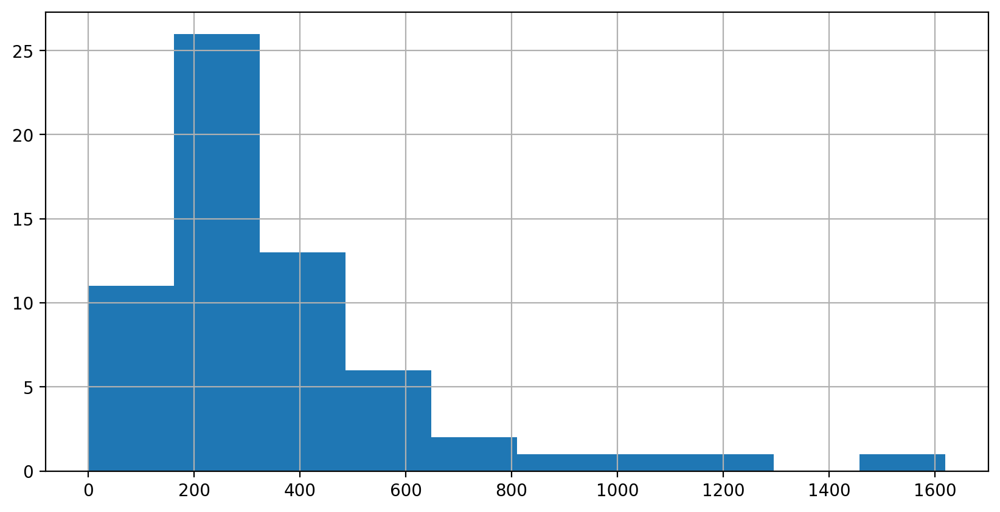

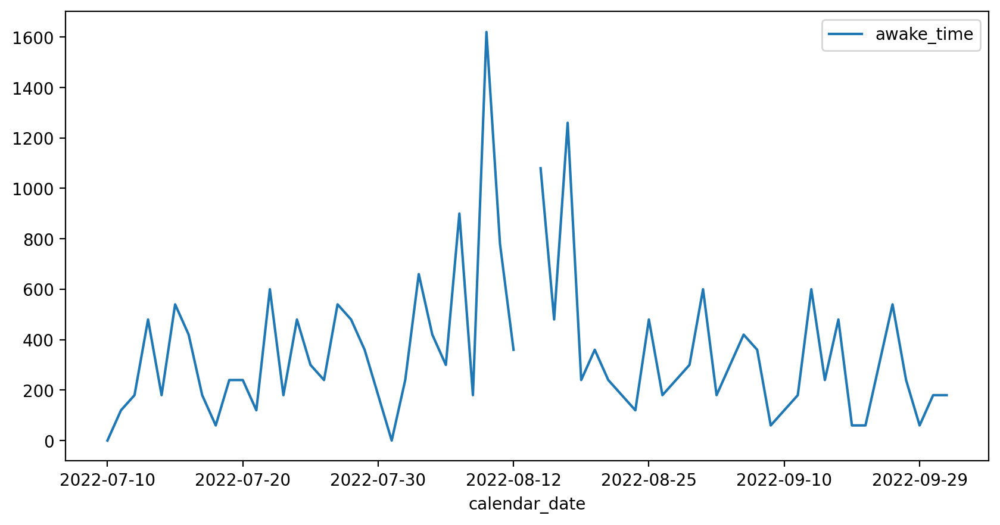

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:                 -0.012
Method:                 Least Squares   F-statistic:                    0.2953
Date:                Sat, 15 Oct 2022   Prob (F-statistic):              0.589
Time:                        14:42:00   Log-Likelihood:                -439.94
No. Observations:                  62   AIC:                             883.9
Df Residuals:                      60   BIC:                             888.1
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        353.2258     37.704      9.368      0.0

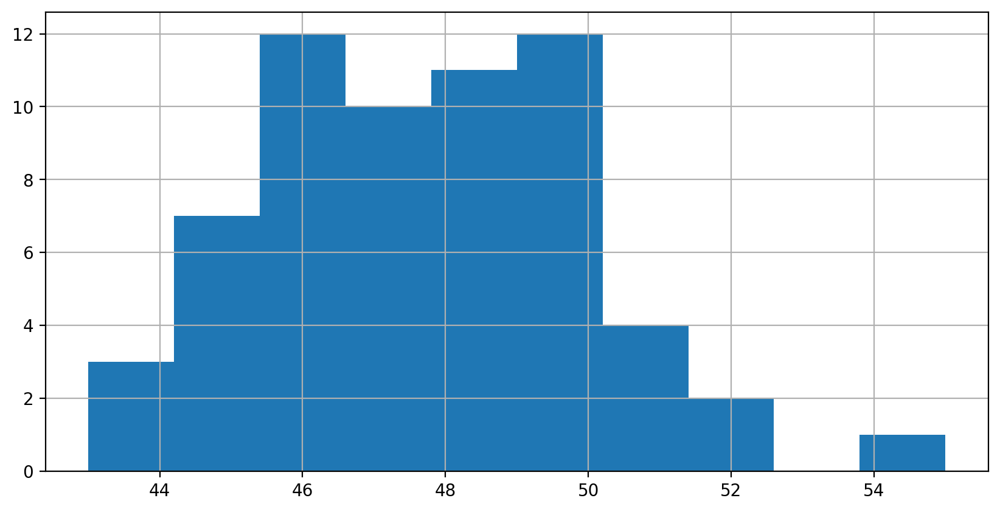

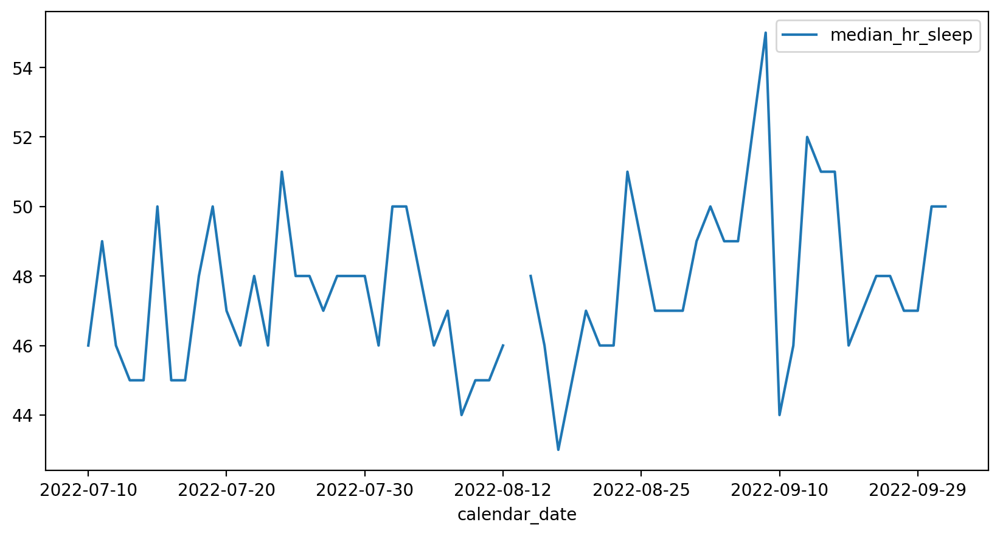

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.076
Model:                            OLS   Adj. R-squared:                  0.061
Method:                 Least Squares   F-statistic:                     4.951
Date:                Sat, 15 Oct 2022   Prob (F-statistic):             0.0299
Time:                        14:42:00   Log-Likelihood:                -136.41
No. Observations:                  62   AIC:                             276.8
Df Residuals:                      60   BIC:                             281.1
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         47.6452      0.282    168.966      0.0

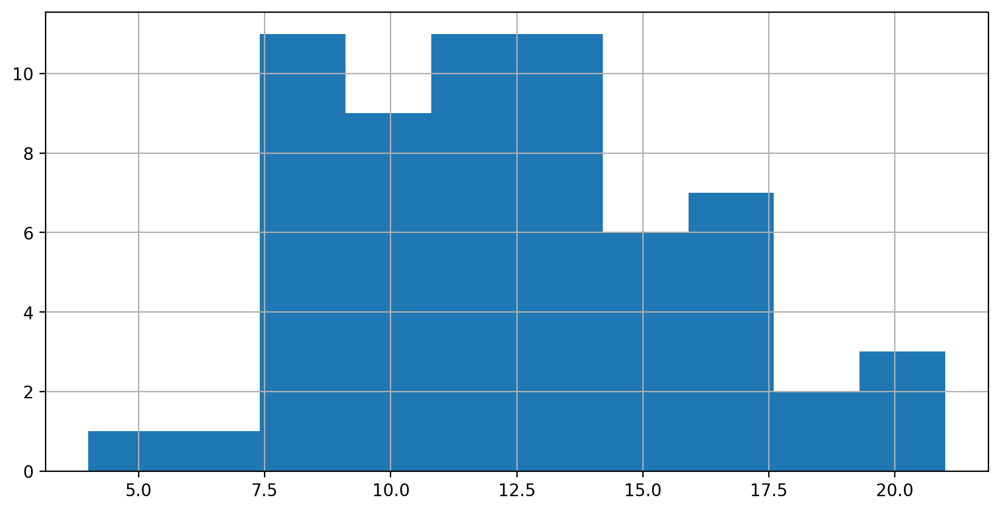

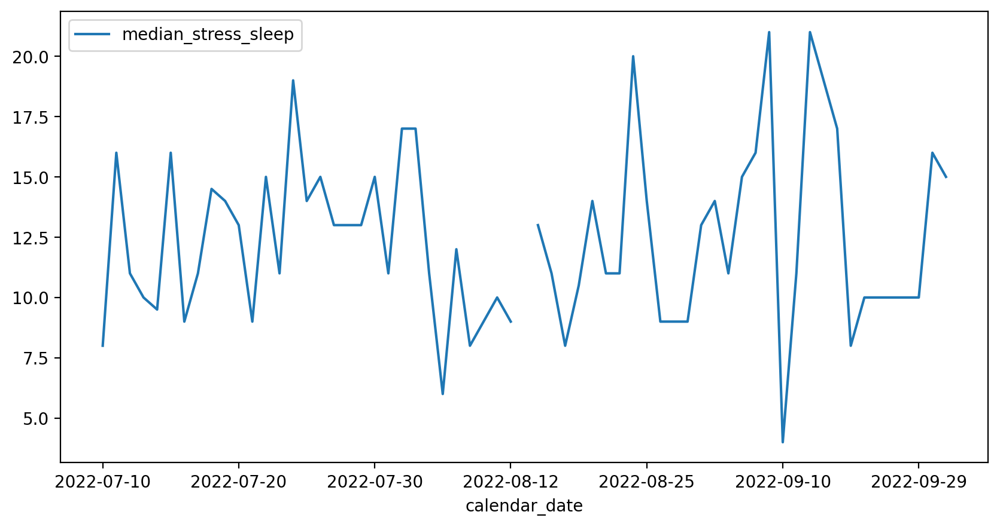

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                 -0.015
Method:                 Least Squares   F-statistic:                   0.08820
Date:                Sat, 15 Oct 2022   Prob (F-statistic):              0.768
Time:                        14:42:00   Log-Likelihood:                -167.34
No. Observations:                  62   AIC:                             338.7
Df Residuals:                      60   BIC:                             342.9
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         12.4113      0.464     26.729      0.0

In [7]:
def do_analysis(variable):
    
    sleep_data[variable].hist()
    plt.show()
    
    sleep_data.plot('calendar_date', variable)
    plt.show()
    mydata = sleep_data.dropna()
    x = mydata['calendar_date'].apply(lambda x: pd.Timestamp(x).timestamp()).values
    X = (x - x.mean())/x.std()
    X = sm.add_constant(X)
    y = mydata[variable].values

    mod = sm.OLS(y, X)
    res = mod.fit()
    print(res.summary())
    
for variable in ['total_sleep_hours_round', 'deep_sleep_time', 'awake_time', 'median_hr_sleep', 'median_stress_sleep' ]:
    do_analysis(variable)
    

Single night

      local_start_time  hr local_start_time_orig  sleep_event_number
5597        1657755240  48   2022-07-13 23:34:00                   4
5598        1657755300  48   2022-07-13 23:35:00                   4
5599        1657755360  47   2022-07-13 23:36:00                   4
5600        1657755420  47   2022-07-13 23:37:00                   4
5601        1657755480  51   2022-07-13 23:38:00                   4
...                ...  ..                   ...                 ...
6086        1657784580  49   2022-07-14 07:43:00                   4
6087        1657784640  48   2022-07-14 07:44:00                   4
6088        1657784700  49   2022-07-14 07:45:00                   4
6089        1657784760  51   2022-07-14 07:46:00                   4
6090        1657784820  51   2022-07-14 07:47:00                   4

[494 rows x 4 columns]


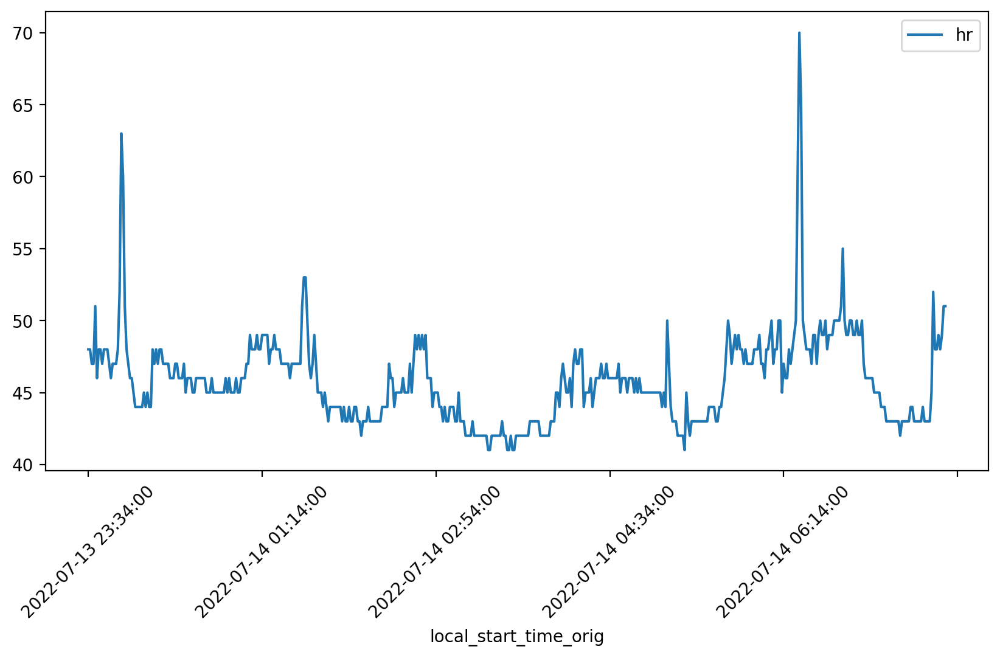

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.142
Model:                            OLS   Adj. R-squared:                  0.137
Method:                 Least Squares   F-statistic:                     27.05
Date:                Sat, 15 Oct 2022   Prob (F-statistic):           3.36e-16
Time:                        14:42:01   Log-Likelihood:                -1218.6
No. Observations:                 494   AIC:                             2445.
Df Residuals:                     490   BIC:                             2462.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         45.7773      0.129    355.378      0.0

In [8]:
WHICH_NIGHT = 4
VARIABLE = 'hr'
sub_data = hr_ext_data[hr_ext_data['sleep_event_number'] == WHICH_NIGHT]

print(sub_data)
sub_data.plot('local_start_time_orig', VARIABLE)
plt.xticks(rotation = 45)
plt.show()

x = sub_data['local_start_time_orig'].apply(lambda x: pd.Timestamp(x).timestamp()).values
x = (x - x.mean())/x.std()

polynomial_features = PolynomialFeatures(degree=3)
scaler = StandardScaler()

X = polynomial_features.fit_transform(x.reshape(-1, 1))
X = scaler.fit_transform(X)
X[:, 0] = 1

y = sub_data[VARIABLE].values

mod = sm.OLS(y, X)
res = mod.fit()
print(res.summary())


Perform exploratory data analysis

  0%|                                                                                         | 0/3239 [00:00<…

C:\Users\Garzon\anaconda3\envs\digbio\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\Garzon\anaconda3\envs\digbio\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\Garzon\anaconda3\envs\digbio\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\Garzon\anaconda3\envs\digbio\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\Garzon\anaconda

DataPrep Report
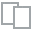
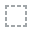
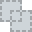
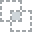
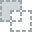
...
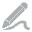
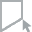
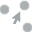
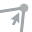
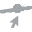

In [9]:
create_report(sleep_data)